<a href="https://colab.research.google.com/github/amudzingwa/AIProject/blob/main/rl_floor_maze_qlearning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 5x4 Human Maze RL (Q-Learning)
Run the cells top-to-bottom. Edit `PATH` at the top of the code cell to change the maze sequence.

In [ ]:
# # 5x4 "Human Maze" RL with Q-Learning (Colab-ready)
# # --------------------------------------------------
# # Concept:
# # - A facilitator knows a secret path (sequence of cells) from START to GOAL on a 5x4 grid.
# # - The agent must discover that path by trial and error.
# # - If it steps on a wrong tile, the episode ends with a penalty (like the real floor maze).
# #
# # State design:
# #   (row, col, k) where k is "how far along the path you are" (index into the path list).
# #   The "next correct tile" is path[k+1]. The agent must move onto that next specific cell.
# #
# # Rewards:
# #   - Move to the correct next path tile: +0.2
# #   - Reach GOAL (final tile): +1.0 and done
# #   - Step on any other tile (including off-path or out-of-sequence): -0.5 and done
# #   - Bumping into walls (out of bounds): small penalty -0.05 (stay in place)
# #
# # Actions: 0:UP, 1:RIGHT, 2:DOWN, 3:LEFT
# #
# # Notes:
# # - This setup mirrors the "electric/silent maze" team-building exercise.
# # - Because sequence matters, the agent must learn both *where* to go and *in what order*.
# # - You can edit the PATH below to try different layouts.
# #
# # Tips:
# # - Increase EPISODES for more stable learning if needed.
# # - Tune EPSILON/ALPHA/GAMMA for different learning behaviors.
# #
# # Author: ChatGPT (Colab-ready single file)
# # --------------------------------------------------

# import numpy as np
# import random
# import math
# import matplotlib.pyplot as plt

# # --- Maze / Path Configuration ---
# GRID_H, GRID_W = 4, 5   # 4 rows (0..3), 5 cols (0..4)

# # Define a valid sequential path as a list of (row, col).
# # Must start somewhere and end somewhere; adjacent steps only.
# # Example path (S -> ... -> G). Feel free to change it!
# PATH = [
#     (3, 0),  # Start (S)
#     (2, 0),
#     (2, 1),
#     (2, 2),
#     (1, 2),
#     (0, 2),
#     (0, 3),
#     (0, 4)   # Goal (G)
# ]

# START = PATH[0]
# GOAL  = PATH[-1]

# # Safety checks
# def _adjacent(a, b):
#     return abs(a[0]-b[0]) + abs(a[1]-b[1]) == 1

# for i in range(len(PATH)-1):
#     assert _adjacent(PATH[i], PATH[i+1]), "PATH must be made of adjacent steps only."

# # --- Environment ---
# ACTIONS = [0,1,2,3]  # UP, RIGHT, DOWN, LEFT
# DELTA = {
#     0: (-1, 0),  # UP
#     1: (0, 1),   # RIGHT
#     2: (1, 0),   # DOWN
#     3: (0, -1)   # LEFT
# }

# class HumanMazeEnv:
#     def __init__(self, grid_h, grid_w, path):
#         self.H = grid_h
#         self.W = grid_w
#         self.path = path
#         self.start = path[0]
#         self.goal  = path[-1]
#         self.reset()

#     def reset(self):
#         # k = 0 means you're standing on path[0] (START). Next required is path[1].
#         self.pos = self.start
#         self.k = 0
#         return (self.pos[0], self.pos[1], self.k)

#     def step(self, action):
#         dr, dc = DELTA[action]
#         nr, nc = self.pos[0] + dr, self.pos[1] + dc

#         # If out of bounds, light penalty, stay in place, not terminal.
#         if not (0 <= nr < self.H and 0 <= nc < self.W):
#             reward = -0.05
#             done = False
#             info = {'note':'bumped wall'}
#             return (self.pos[0], self.pos[1], self.k), reward, done, info

#         # Candidate next cell
#         new_cell = (nr, nc)

#         # What is the next required cell along the secret path?
#         next_required = None if self.k >= len(self.path)-1 else self.path[self.k+1]

#         # If already at GOAL, episode should be done (but let's just be safe)
#         if self.pos == self.goal:
#             return (self.pos[0], self.pos[1], self.k), 0.0, True, {'note':'already at goal'}

#         # If we step onto the exact required next tile:
#         if next_required is not None and new_cell == next_required:
#             self.pos = new_cell
#             self.k += 1
#             if self.pos == self.goal:
#                 return (self.pos[0], self.pos[1], self.k), 1.0, True, {'note':'goal'}
#             else:
#                 return (self.pos[0], self.pos[1], self.k), 0.2, False, {'note':'correct step'}

#         # Otherwise, it's a wrong tile (including other path tiles out of sequence)
#         # Episode ends with a penalty.
#         return (self.pos[0], self.pos[1], self.k), -0.5, True, {'note':'wrong tile'}

#     def render_ascii(self, highlight=None):
#         # highlight: optional set of coords to mark (e.g., learned path); displayed as '*'
#         grid = [[' .' for _ in range(self.W)] for _ in range(self.H)]
#         for r,c in self.path:
#             grid[r][c] = ' o'  # show the secret path with 'o' (for debugging/teaching)
#         sr, sc = self.start
#         gr, gc = self.goal
#         grid[sr][sc] = ' S'
#         grid[gr][gc] = ' G'
#         if highlight:
#             for (r,c) in highlight:
#                 if (r,c) not in [self.start, self.goal]:
#                     grid[r][c] = ' *'
#         print('\n'.join(''.join(row) for row in grid))

# # --- Q-Learning Agent ---
# class QAgent:
#     def __init__(self, env, alpha=0.2, gamma=0.95, epsilon=1.0, epsilon_min=0.05, epsilon_decay=0.995):
#         self.env = env
#         self.alpha = alpha
#         self.gamma = gamma
#         self.epsilon = epsilon
#         self.epsilon_min = epsilon_min
#         self.epsilon_decay = epsilon_decay

#         # Q-table as dict: key = (r,c,k), value = np.array(len(ACTIONS))
#         self.Q = {}

#     def _ensure_state(self, state):
#         if state not in self.Q:
#             self.Q[state] = np.zeros(len(ACTIONS), dtype=float)

#     def choose_action(self, state):
#         self._ensure_state(state)
#         if random.random() < self.epsilon:
#             return random.choice(ACTIONS)
#         else:
#             return int(np.argmax(self.Q[state]))

#     def learn(self, s, a, r, s_next, done):
#         self._ensure_state(s)
#         self._ensure_state(s_next)
#         q_sa = self.Q[s][a]
#         target = r if done else r + self.gamma * np.max(self.Q[s_next])
#         self.Q[s][a] = q_sa + self.alpha * (target - q_sa)

#     def decay_epsilon(self):
#         self.epsilon = max(self.epsilon_min, self.epsilon * self.epsilon_decay)

# # --- Training ---
# def train(env, agent, episodes=1500, max_steps=200, eval_window=50):
#     rewards = []
#     success_flags = []  # 1 if reached goal, 0 otherwise

#     for ep in range(episodes):
#         s = env.reset()
#         ep_reward = 0.0
#         for t in range(max_steps):
#             a = agent.choose_action(s)
#             s_next, r, done, info = env.step(a)
#             agent.learn(s, a, r, s_next, done)
#             ep_reward += r
#             s = s_next
#             if done:
#                 success_flags.append(1 if info.get('note') == 'goal' else 0)
#                 break
#         rewards.append(ep_reward)
#         agent.decay_epsilon()

#     # moving averages for plotting
#     def moving_avg(arr, k):
#         if len(arr) < k:
#             return []
#         out = []
#         for i in range(k-1, len(arr)):
#             out.append(sum(arr[i-k+1:i+1])/k)
#         return out

#     return {
#         'rewards': rewards,
#         'success_flags': success_flags,
#         'rewards_ma': moving_avg(rewards, eval_window),
#         'success_ma': moving_avg(success_flags, eval_window),
#         'eval_window': eval_window
#     }

# # --- Policy Extraction & Visualization ---
# ARROWS = {0:'↑', 1:'→', 2:'↓', 3:'←'}

# def greedy_action(agent, state):
#     agent._ensure_state(state)
#     return int(np.argmax(agent.Q[state]))

# def extract_greedy_path(env, agent, max_steps=200):
#     """Rollout using the greedy policy (epsilon=0). Return the visited sequence until done."""
#     s = env.reset()
#     visited = [ (env.pos[0], env.pos[1]) ]
#     for _ in range(max_steps):
#         a = greedy_action(agent, s)
#         s_next, r, done, info = env.step(a)
#         if (env.pos[0], env.pos[1]) != visited[-1]:
#             visited.append((env.pos[0], env.pos[1]))
#         s = s_next
#         if done:
#             break
#     return visited, info

# def show_policy_arrows(env, agent):
#     """Prints a grid of best actions from each (r,c,k=correct-in-sequence) state where k is implied by being on the path."""
#     # We'll show arrows only along the *true path* states to keep the view simple.
#     display = [['  ' for _ in range(env.W)] for _ in range(env.H)]
#     for k, (r,c) in enumerate(env.path[:-1]):  # no arrow on the last (goal) cell
#         s = (r,c,k)
#         agent._ensure_state(s)
#         a = int(np.argmax(agent.Q[s]))
#         display[r][c] = ARROWS[a]
#     # Mark Start/Goal
#     sr, sc = env.start
#     gr, gc = env.goal
#     display[sr][sc] = 'S '
#     display[gr][gc] = 'G '
#     print("Greedy policy along the path (arrows show best action at each step):")
#     print('\n'.join(''.join(row) for row in display))

# # --- Main demo ---
# if __name__ == "__main__":
#     env = HumanMazeEnv(GRID_H, GRID_W, PATH)
#     agent = QAgent(env,
#                    alpha=0.25,
#                    gamma=0.98,
#                    epsilon=1.0,
#                    epsilon_min=0.05,
#                    epsilon_decay=0.995)

#     stats = train(env, agent, episodes=1500, max_steps=100, eval_window=50)

#     # Plot: moving average of rewards
#     plt.figure()
#     if len(stats['rewards_ma']) > 0:
#         xs = list(range(stats['eval_window']-1, len(stats['rewards'])))
#         plt.plot(xs, stats['rewards_ma'])
#         plt.title("Moving Average of Episode Rewards")
#         plt.xlabel("Episode")
#         plt.ylabel("Reward ({}-episode MA)".format(stats['eval_window']))
#         plt.tight_layout()
#         plt.show()

#     # Plot: moving average of success rate
#     plt.figure()
#     if len(stats['success_ma']) > 0:
#         xs = list(range(stats['eval_window']-1, len(stats['success_flags'])))
#         plt.plot(xs, stats['success_ma'])
#         plt.title("Moving Average of Success Rate")
#         plt.xlabel("Episode")
#         plt.ylabel("Success Rate ({}-episode MA)".format(stats['eval_window']))
#         plt.tight_layout()
#         plt.show()

#     # Show learned greedy rollout
#     visited, info = extract_greedy_path(env, agent)
#     print("\nGreedy rollout visited cells:", visited)
#     print("Termination info:", info)

#     # Show the secret path and (optionally) the visited path highlighted
#     print("\nSecret path (for teaching/debugging):")
#     env.render_ascii(highlight=set(visited))

#     # Show arrows (best action) along the true path states
#     print()
#     show_policy_arrows(env, agent)

#     # How to customize:
#     print("\nTo customize the maze path, edit the PATH list at the top and rerun.")

In [ ]:
# import time
# from IPython.display import clear_output

# def play_episode_text(env, q_table, delay=0.5, max_steps=50):
#     """
#     Play one episode using the learned Q-table and print step-by-step.
#     """
#     state = env.reset()
#     done = False
#     steps = 0

#     while not done and steps < max_steps:
#         # Clear previous output
#         clear_output(wait=True)

#         # Print the maze
#         for r in range(env.H):  # use H and W
#             row_str = ""
#             for c in range(env.W):
#                 if (r, c) == env.pos:  # use pos
#                     row_str += " A "  # Agent position
#                 elif (r, c) in env.path:
#                     row_str += " . "  # Correct path tile
#                 else:
#                     row_str += " _ "  # Empty tile
#             print(row_str)

#         time.sleep(delay)

#         # Take next action
#         action = np.argmax(q_table[state])
#         state, reward, done, _ = env.step(action)
#         steps += 1

#     print("\nEpisode finished.")


In [ ]:
# play_episode_text(env, q_table, delay=0.5)
# play_episode_text(env, agent.Q, delay=0.5)



In [ ]:
# import time
# from IPython.display import clear_output

# def train_with_visual_errors(env, agent, episodes=200, max_steps=50, display_every=10, delay=0.2):
#     """
#     Train Q-learning agent and show live text-based maze with visual errors.
#     Correct path learned so far: '.'
#     Agent: 'A'
#     Wrong steps: 'X'
#     """
#     rewards = []

#     for ep in range(1, episodes+1):
#         state = env.reset()
#         ep_reward = 0
#         wrong_steps = set()  # store coordinates where the agent made a wrong move

#         for step in range(max_steps):
#             action = agent.choose_action(state)
#             next_state, reward, done, info = env.step(action)
#             agent.learn(state, action, reward, next_state, done)
#             ep_reward += reward

#             # Track wrong steps
#             if reward < 0 and info.get('note') == 'wrong tile':
#                 wrong_steps.add(env.pos)

#             state = next_state

#             # Display live maze occasionally
#             if ep % display_every == 0:
#                 clear_output(wait=True)
#                 print(f"Episode {ep}, Step {step+1}, Reward {ep_reward:.2f}, Info: {info}")
#                 for r in range(env.H):
#                     row_str = ""
#                     for c in range(env.W):
#                         if (r, c) == env.pos:
#                             row_str += " A "  # Agent
#                         elif (r, c) in wrong_steps:
#                             row_str += " X "  # Wrong steps
#                         elif (r, c) in env.path[:env.k+1]:
#                             row_str += " . "  # Correct path learned so far
#                         else:
#                             row_str += " _ "  # Unvisited/unknown
#                     print(row_str)
#                 time.sleep(delay)

#             if done:
#                 break

#         rewards.append(ep_reward)
#         agent.decay_epsilon()

#     print("Training finished.")
#     return rewards


In [ ]:
# # Train agent and watch mistakes and learning
# rewards = train_with_visual_errors(env, agent,
#                                    episodes=200,   # adjust for speed
#                                    max_steps=50,
#                                    display_every=5,  # show maze every 5 episodes
#                                    delay=0.3)       # seconds per display


In [ ]:
import numpy as np
import time
from IPython.display import clear_output
from collections import defaultdict

# -----------------------------
# Maze Environment
# -----------------------------
class HumanMazeEnv:
    def __init__(self, H=5, W=4, path=None):
        self.H = H
        self.W = W
        self.path = path if path else [(0,0),(0,1),(1,1),(2,1),(2,2),(3,2),(4,2),(4,3)]
        self.start = self.path[0]
        self.reset()
        self.k = 0  # index along the correct path

    def reset(self):
        self.pos = self.start
        self.k = 0
        return self.state()

    def state(self):
        return (self.pos[0], self.pos[1], self.k)

    def step(self, action):
        # 0=up,1=down,2=left,3=right
        r, c = self.pos
        if action == 0: r -= 1
        elif action == 1: r += 1
        elif action == 2: c -= 1
        elif action == 3: c += 1

        # Check boundaries
        if r<0 or r>=self.H or c<0 or c>=self.W:
            return self.state(), -0.05, False, {'note':'wall'}

        self.pos = (r,c)
        done = False
        reward = -0.01
        info = {}

        # Check correct path
        if self.k < len(self.path) and self.pos == self.path[self.k+1 if self.k+1<len(self.path) else self.k]:
            self.k += 1
            reward = 0.2
        elif self.pos not in self.path:
            reward = -0.5
            done = True
            info['note'] = 'wrong tile'

        # Goal reached
        if self.pos == self.path[-1]:
            reward = 1.0
            done = True
            info['note'] = 'goal'

        return self.state(), reward, done, info

# -----------------------------
# Q-Learning Agent
# -----------------------------
class QAgent:
    def __init__(self, n_actions=4, lr=0.5, gamma=0.9, epsilon=0.3):
        self.n_actions = n_actions
        self.lr = lr
        self.gamma = gamma
        self.epsilon = epsilon
        self.Q = defaultdict(lambda: np.zeros(n_actions))

    def choose_action(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.n_actions)  # explore
        return np.argmax(self.Q[state])            # exploit

    def learn(self, state, action, reward, next_state, done):
        q_predict = self.Q[state][action]
        q_target = reward + self.gamma * np.max(self.Q[next_state]) * (0 if done else 1)
        self.Q[state][action] += self.lr * (q_target - q_predict)

    def decay_epsilon(self, decay=0.99):
        self.epsilon *= decay

# -----------------------------
# Training with live visual errors
# -----------------------------
def train_with_visual_errors(env, agent, episodes=100, max_steps=50, display_every=1, delay=0.2):
    rewards = []

    for ep in range(1, episodes+1):
        state = env.reset()
        ep_reward = 0
        wrong_steps = set()

        for step in range(max_steps):
            action = agent.choose_action(state)
            next_state, reward, done, info = env.step(action)
            agent.learn(state, action, reward, next_state, done)
            ep_reward += reward

            # Track wrong steps
            if reward < 0 and info.get('note') == 'wrong tile':
                wrong_steps.add(env.pos)

            state = next_state

            # Display live maze
            if ep % display_every == 0:
                clear_output(wait=True)
                print(f"Episode {ep}, Step {step+1}, Reward {ep_reward:.2f}, Info: {info}")
                for r in range(env.H):
                    row_str = ""
                    for c in range(env.W):
                        if (r, c) == env.pos:
                            row_str += " A "  # Agent
                        elif (r, c) in wrong_steps:
                            row_str += " X "  # Wrong step
                        elif (r, c) in env.path[:env.k+1]:
                            row_str += " . "  # Correct path so far
                        else:
                            row_str += " _ "  # Unvisited
                    print(row_str)
                time.sleep(delay)

            if done:
                break

        rewards.append(ep_reward)
        agent.decay_epsilon()

    print("Training finished.")
    return rewards

# -----------------------------
# Run the full example
# -----------------------------
env = HumanMazeEnv()
agent = QAgent()

# Train and watch agent learn from mistakes
rewards = train_with_visual_errors(env, agent,
                                   episodes=50,   # fewer for fast demo
                                   max_steps=50,
                                   display_every=1,
                                   delay=0.3)


Episode 50, Step 7, Reward 2.20, Info: {'note': 'goal'}
 .  .  _  _ 
 _  .  _  _ 
 _  .  .  _ 
 _  _  .  _ 
 _  _  .  A 
Training finished.


In [ ]:
def replay_episode(env, agent, max_steps=50, delay=0.3):
    """
    Play one episode after training and display step-by-step with visual errors.
    """
    state = env.reset()
    done = False
    steps = 0
    wrong_steps = set()

    while not done and steps < max_steps:
        clear_output(wait=True)
        print(f"Replay Step {steps+1}")

        # Draw the maze
        for r in range(env.H):
            row_str = ""
            for c in range(env.W):
                if (r, c) == env.pos:
                    row_str += " A "
                elif (r, c) in wrong_steps:
                    row_str += " X "
                elif (r, c) in env.path[:env.k+1]:
                    row_str += " . "
                else:
                    row_str += " _ "
            print(row_str)

        # Take greedy action
        action = np.argmax(agent.Q[state])
        next_state, reward, done, info = env.step(action)

        if reward < 0 and info.get('note') == 'wrong tile':
            wrong_steps.add(env.pos)

        state = next_state
        steps += 1
        time.sleep(delay)

    print("\nReplay finished!")


In [ ]:
replay_episode(env, agent, max_steps=50, delay=0.3)


Replay Step 7
 .  .  _  _ 
 _  .  _  _ 
 _  .  .  _ 
 _  _  .  _ 
 _  _  A  _ 

Replay finished!


In [ ]:
# import matplotlib.pyplot as plt
# import matplotlib.animation as animation
# from IPython.display import HTML

# def animate_episode(env, agent, episode_max_steps=50, delay=500):
#     """
#     Animate one episode using the trained Q-table.
#     Colors:
#     - Blue = agent
#     - Green = correct path tiles
#     - Red = wrong steps
#     - Light gray = empty/unvisited
#     """
#     # Reset environment
#     state = env.reset()
#     done = False
#     steps = 0
#     positions = [env.pos]
#     wrong_steps = set()

#     while not done and steps < episode_max_steps:
#         action = np.argmax(agent.Q[state])
#         next_state, reward, done, info = env.step(action)
#         if reward < 0 and info.get('note') == 'wrong tile':
#             wrong_steps.add(env.pos)
#         state = next_state
#         positions.append(env.pos)
#         steps += 1

#     # Set up figure
#     fig, ax = plt.subplots()
#     ax.set_aspect('equal')
#     ax.axis('off')

#     def update(frame):
#         ax.clear()
#         # Draw all tiles
#         for r in range(env.H):
#             for c in range(env.W):
#                 color = 'lightgray'
#                 if (r,c) in env.path[:env.k+1]:
#                     color = '#b2fab4'  # green for correct path
#                 if (r,c) in wrong_steps:
#                     color = 'salmon'   # red for wrong steps
#                 rect = plt.Rectangle((c, env.H - r - 1), 1, 1, facecolor=color, edgecolor='black')
#                 ax.add_patch(rect)
#         # Draw agent
#         ar, ac = positions[frame]
#         rect = plt.Rectangle((ac, env.H - ar - 1), 1, 1, facecolor='dodgerblue', edgecolor='black')
#         ax.add_patch(rect)
#         ax.set_xlim(0, env.W)
#         ax.set_ylim(0, env.H)
#         ax.set_title(f"Step {frame+1} / {len(positions)}")

#     ani = animation.FuncAnimation(fig, update, frames=len(positions), interval=delay, repeat=False)
#     return HTML(ani.to_jshtml())


In [ ]:
# # Animate a single episode after training
# animate_episode(env, agent, episode_max_steps=50, delay=500)


In [ ]:
# import matplotlib.pyplot as plt
# import matplotlib.animation as animation
# from IPython.display import HTML, clear_output
# import numpy as np

# def train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=300):
#     """
#     Train agent and animate its behavior during training.
#     delay: milliseconds per frame
#     """
#     fig, ax = plt.subplots()
#     ax.set_aspect('equal')
#     ax.axis('off')
#     frames_data = []  # store positions and wrong steps for animation

#     for ep in range(1, episodes+1):
#         state = env.reset()
#         done = False
#         wrong_steps = set()

#         for step in range(max_steps):
#             action = agent.choose_action(state)
#             next_state, reward, done, info = env.step(action)
#             agent.learn(state, action, reward, next_state, done)

#             # Track wrong steps
#             if reward < 0 and info.get('note') == 'wrong tile':
#                 wrong_steps.add(env.pos)

#             state = next_state

#             # Record for animation occasionally
#             if ep % display_every == 0:
#                 frames_data.append((env.pos, list(wrong_steps), ep, step))

#             if done:
#                 break

#         agent.decay_epsilon()

#     # Animation update function
#     def update(frame):
#         ax.clear()
#         pos, wrong, ep_num, step_num = frames_data[frame]

#         for r in range(env.H):
#             for c in range(env.W):
#                 color = 'lightgray'
#                 if (r,c) in env.path[:env.k+1]:
#                     color = '#b2fab4'  # green correct path
#                 if (r,c) in wrong:
#                     color = 'salmon'   # red wrong step
#                 rect = plt.Rectangle((c, env.H - r - 1), 1, 1, facecolor=color, edgecolor='black')
#                 ax.add_patch(rect)

#         # Draw agent
#         ar, ac = pos
#         rect = plt.Rectangle((ac, env.H - ar - 1), 1, 1, facecolor='dodgerblue', edgecolor='black')
#         ax.add_patch(rect)

#         ax.set_xlim(0, env.W)
#         ax.set_ylim(0, env.H)
#         ax.set_title(f"Episode {ep_num}, Step {step_num+1}, Epsilon: {agent.epsilon:.2f}")

#     ani = animation.FuncAnimation(fig, update, frames=len(frames_data), interval=delay, repeat=False)
#     return H


In [ ]:
# # Reset agent and environment for training
# agent.Q = {}          # start fresh
# agent.epsilon = 0.3   # allow exploration

# # Train and watch training animation
# train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=200)


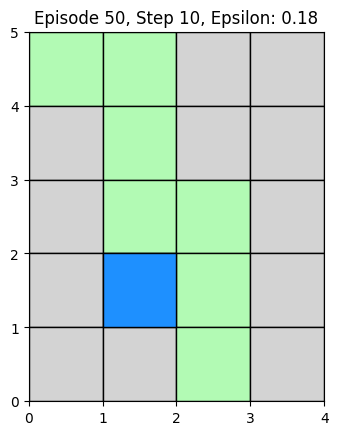

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from collections import defaultdict
from IPython.display import HTML, clear_output
import time

# -----------------------------
# Maze Environment
# -----------------------------
class HumanMazeEnv:
    def __init__(self, H=5, W=4, path=None):
        self.H = H
        self.W = W
        self.path = path if path else [(0,0),(0,1),(1,1),(2,1),(2,2),(3,2),(4,2),(4,3)]
        self.start = self.path[0]
        self.reset()
        self.k = 0  # index along the correct path

    def reset(self):
        self.pos = self.start
        self.k = 0
        return self.state()

    def state(self):
        return (self.pos[0], self.pos[1], self.k)

    def step(self, action):
        # 0=up,1=down,2=left,3=right
        r, c = self.pos
        if action == 0: r -= 1
        elif action == 1: r += 1
        elif action == 2: c -= 1
        elif action == 3: c += 1

        # Check boundaries
        if r<0 or r>=self.H or c<0 or c>=self.W:
            return self.state(), -0.05, False, {'note':'wall'}

        self.pos = (r,c)
        done = False
        reward = -0.01
        info = {}

        # Check correct path
        if self.k < len(self.path) and self.pos == self.path[self.k+1 if self.k+1<len(self.path) else self.k]:
            self.k += 1
            reward = 0.2
        elif self.pos not in self.path:
            reward = -0.5
            done = True
            info['note'] = 'wrong tile'

        # Goal reached
        if self.pos == self.path[-1]:
            reward = 1.0
            done = True
            info['note'] = 'goal'

        return self.state(), reward, done, info

# -----------------------------
# Q-Learning Agent
# -----------------------------
class QAgent:
    def __init__(self, n_actions=4, lr=0.5, gamma=0.9, epsilon=0.3):
        self.n_actions = n_actions
        self.lr = lr
        self.gamma = gamma
        self.epsilon = epsilon
        self.Q = defaultdict(lambda: np.zeros(n_actions))

    def choose_action(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.n_actions)  # explore
        return np.argmax(self.Q[state])            # exploit

    def learn(self, state, action, reward, next_state, done):
        q_predict = self.Q[state][action]
        q_target = reward + self.gamma * np.max(self.Q[next_state]) * (0 if done else 1)
        self.Q[state][action] += self.lr * (q_target - q_predict)

    def decay_epsilon(self, decay=0.99):
        self.epsilon *= decay

# -----------------------------
# Animated Training Function
# -----------------------------
def train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=200):
    """
    Train agent and animate behavior during training.
    delay: milliseconds per frame
    """
    frames_data = []  # store frames

    for ep in range(1, episodes+1):
        state = env.reset()
        done = False
        wrong_steps = set()

        for step in range(max_steps):
            action = agent.choose_action(state)
            next_state, reward, done, info = env.step(action)
            agent.learn(state, action, reward, next_state, done)

            # Track wrong steps
            if reward < 0 and info.get('note') == 'wrong tile':
                wrong_steps.add(env.pos)

            state = next_state

            # Record for animation
            if ep % display_every == 0:
                frames_data.append((env.pos, list(wrong_steps), ep, step))

            if done:
                break

        agent.decay_epsilon()

    # Animation setup
    fig, ax = plt.subplots()
    ax.set_aspect('equal')
    ax.axis('off')

    def update(frame):
        ax.clear()
        pos, wrong, ep_num, step_num = frames_data[frame]

        for r in range(env.H):
            for c in range(env.W):
                color = 'lightgray'
                if (r,c) in env.path[:env.k+1]:
                    color = '#b2fab4'  # green correct path
                if (r,c) in wrong:
                    color = 'salmon'   # red wrong steps
                rect = plt.Rectangle((c, env.H - r - 1), 1, 1, facecolor=color, edgecolor='black')
                ax.add_patch(rect)

        # Draw agent
        ar, ac = pos
        rect = plt.Rectangle((ac, env.H - ar - 1), 1, 1, facecolor='dodgerblue', edgecolor='black')
        ax.add_patch(rect)

        ax.set_xlim(0, env.W)
        ax.set_ylim(0, env.H)
        ax.set_title(f"Episode {ep_num}, Step {step_num+1}, Epsilon: {agent.epsilon:.2f}")

    ani = animation.FuncAnimation(fig, update, frames=len(frames_data), interval=delay, repeat=False)
    return HTML(ani.to_jshtml())

# -----------------------------
# Run Training Animation
# -----------------------------
env = HumanMazeEnv()
agent = QAgent()
agent.Q = defaultdict(lambda: np.zeros(agent.n_actions))
agent.epsilon = 0.3  # exploration

# Run animation
train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=200)


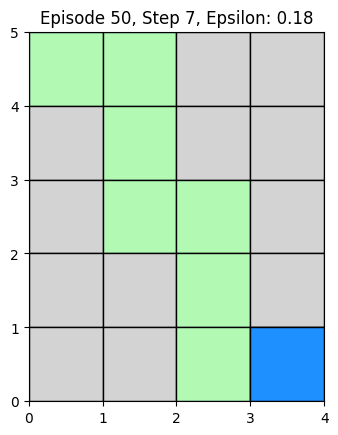

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from collections import defaultdict
from IPython.display import HTML, clear_output

# -----------------------------
# Maze Environment
# -----------------------------
class HumanMazeEnv:
    def __init__(self, H=5, W=4, path=None):
        self.H = H
        self.W = W
        self.path = path if path else [(0,0),(0,1),(1,1),(2,1),(2,2),(3,2),(4,2),(4,3)]
        self.start = self.path[0]
        self.reset()
        self.k = 0  # index along the correct path

    def reset(self):
        self.pos = self.start
        self.k = 0
        return self.state()

    def state(self):
        return (self.pos[0], self.pos[1], self.k)

    def step(self, action):
        # 0=up,1=down,2=left,3=right
        r, c = self.pos
        if action == 0: r -= 1
        elif action == 1: r += 1
        elif action == 2: c -= 1
        elif action == 3: c += 1

        # Check boundaries
        if r<0 or r>=self.H or c<0 or c>=self.W:
            return self.state(), -0.05, False, {'note':'wall'}

        self.pos = (r,c)
        done = False
        reward = -0.01
        info = {}

        # Check correct path
        if self.k < len(self.path) and self.pos == self.path[self.k+1 if self.k+1<len(self.path) else self.k]:
            self.k += 1
            reward = 0.2
        elif self.pos not in self.path:
            reward = -0.5
            done = True
            info['note'] = 'wrong tile'

        # Goal reached
        if self.pos == self.path[-1]:
            reward = 1.0
            done = True
            info['note'] = 'goal'

        return self.state(), reward, done, info

# -----------------------------
# Q-Learning Agent
# -----------------------------
class QAgent:
    def __init__(self, n_actions=4, lr=0.5, gamma=0.9, epsilon=0.3):
        self.n_actions = n_actions
        self.lr = lr
        self.gamma = gamma
        self.epsilon = epsilon
        self.Q = defaultdict(lambda: np.zeros(n_actions))

    def choose_action(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.choice(self.n_actions)  # explore
        return np.argmax(self.Q[state])            # exploit

    def learn(self, state, action, reward, next_state, done):
        q_predict = self.Q[state][action]
        q_target = reward + self.gamma * np.max(self.Q[next_state]) * (0 if done else 1)
        self.Q[state][action] += self.lr * (q_target - q_predict)

    def decay_epsilon(self, decay=0.99):
        self.epsilon *= decay

# -----------------------------
# Animated Training Function (fixed wrong steps)
# -----------------------------
def train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=200):
    """
    Train agent and animate behavior during training.
    Shows correct path (green), wrong steps (red), and agent (blue).
    """
    frames_data = []  # store snapshots

    for ep in range(1, episodes+1):
        state = env.reset()
        done = False
        wrong_steps = set()
        correct_path = set([env.pos])  # start with initial position

        for step in range(max_steps):
            action = agent.choose_action(state)
            next_state, reward, done, info = env.step(action)
            agent.learn(state, action, reward, next_state, done)
            state = next_state

            # Update correct path and wrong steps
            if reward > 0:
                correct_path.add(env.pos)
            elif reward < 0 and info.get('note') == 'wrong tile':
                wrong_steps.add(env.pos)

            # Record snapshot for animation
            if ep % display_every == 0:
                frames_data.append((env.pos, list(correct_path), list(wrong_steps), ep, step))

            if done:
                break

        agent.decay_epsilon()

    # Animation setup
    fig, ax = plt.subplots()
    ax.set_aspect('equal')
    ax.axis('off')

    def update(frame):
        ax.clear()
        pos, correct, wrong, ep_num, step_num = frames_data[frame]

        for r in range(env.H):
            for c in range(env.W):
                color = 'lightgray'
                if (r,c) in correct:
                    color = '#b2fab4'  # green for correct path
                if (r,c) in wrong:
                    color = 'salmon'   # red for wrong steps
                rect = plt.Rectangle((c, env.H - r - 1), 1, 1, facecolor=color, edgecolor='black')
                ax.add_patch(rect)

        # Draw agent
        ar, ac = pos
        rect = plt.Rectangle((ac, env.H - ar - 1), 1, 1, facecolor='dodgerblue', edgecolor='black')
        ax.add_patch(rect)

        ax.set_xlim(0, env.W)
        ax.set_ylim(0, env.H)
        ax.set_title(f"Episode {ep_num}, Step {step_num+1}, Epsilon: {agent.epsilon:.2f}")

    ani = animation.FuncAnimation(fig, update, frames=len(frames_data), interval=delay, repeat=False)
    return HTML(ani.to_jshtml())

# -----------------------------
# Run the Training Animation
# -----------------------------
env = HumanMazeEnv()
agent = QAgent()
agent.Q = defaultdict(lambda: np.zeros(agent.n_actions))
agent.epsilon = 0.3  # allow exploration

train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=200)


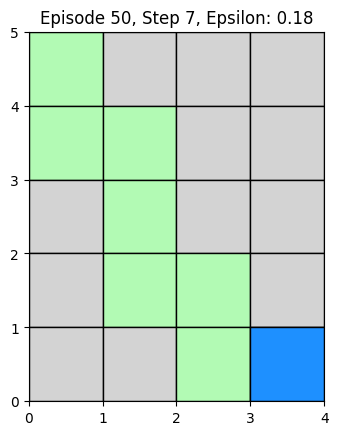

In [ ]:
# Define a new path
new_path = [(0,0),(1,0),(1,1),(2,1),(3,1),(3,2),(4,2),(4,3)]

# Create the environment with the new path
env = HumanMazeEnv(path=new_path)

# Reset and prepare the agent
agent.Q = defaultdict(lambda: np.zeros(agent.n_actions))
agent.epsilon = 0.3

# Call the training animation function
train_with_animation(env, agent, episodes=50, max_steps=50, display_every=1, delay=200)


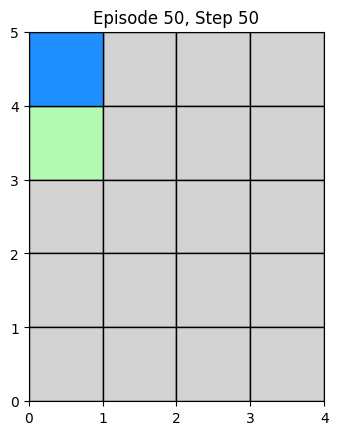

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch
import torch.nn as nn
import torch.optim as optim
import random

# -----------------------------
# Maze Environment
# -----------------------------
class HumanMazeEnv:
    def __init__(self, H=5, W=4, path=None):
        self.H = H
        self.W = W
        self.path = path if path else [(0,0),(0,1),(1,1),(2,1),(2,2),(3,2),(4,2),(4,3)]
        self.start = self.path[0]
        self.reset()
        self.k = 0  # progress along path

    def reset(self):
        self.pos = self.start
        self.k = 0
        return self.state()

    def state(self):
        return (self.pos[0], self.pos[1], self.k)

    def step(self, action):
        r, c = self.pos
        if action == 0: r -= 1
        elif action == 1: r += 1
        elif action == 2: c -= 1
        elif action == 3: c += 1

        # Boundary check
        if r<0 or r>=self.H or c<0 or c>=self.W:
            return self.state(), -0.05, False, {'note':'wall'}

        self.pos = (r,c)
        done = False
        reward = -0.01
        info = {}

        if self.k < len(self.path) and self.pos == self.path[self.k+1 if self.k+1<len(self.path) else self.k]:
            self.k += 1
            reward = 0.2
        elif self.pos not in self.path:
            reward = -0.5
            done = True
            info['note'] = 'wrong tile'

        if self.pos == self.path[-1]:
            reward = 1.0
            done = True
            info['note'] = 'goal'

        return self.state(), reward, done, info

# -----------------------------
# Neural Network Policy
# -----------------------------
class PolicyNN(nn.Module):
    def __init__(self, input_size=3, hidden=32, output_size=4):
        super().__init__()
        self.fc = nn.Sequential(
            nn.Linear(input_size, hidden),
            nn.ReLU(),
            nn.Linear(hidden, output_size)
        )

    def forward(self, x):
        return self.fc(x)  # logits

# -----------------------------
# Training function
# -----------------------------
def train_nn_policy(env, policy, episodes=100, max_steps=50, lr=0.01, display_every=5, delay=200):
    optimizer = optim.Adam(policy.parameters(), lr=lr)
    frames_data = []

    for ep in range(1, episodes+1):
        state = env.reset()
        done = False
        wrong_steps = set()
        correct_path = set([env.pos])
        episode_memory = []

        for step in range(max_steps):
            # Convert state to tensor
            state_tensor = torch.tensor(state, dtype=torch.float32).unsqueeze(0)
            logits = policy(state_tensor)
            probs = torch.softmax(logits, dim=-1)
            action = np.random.choice(4, p=probs.detach().numpy().flatten())

            next_state, reward, done, info = env.step(action)
            episode_memory.append((state_tensor, action, reward, next_state))
            state = next_state

            if reward > 0:
                correct_path.add(env.pos)
            elif reward < 0 and info.get('note') == 'wrong tile':
                wrong_steps.add(env.pos)

            if ep % display_every == 0:
                frames_data.append((env.pos, list(correct_path), list(wrong_steps.copy()), ep, step))

            if done:
                break

        # Compute simple policy gradient-like loss: maximize rewards
        optimizer.zero_grad()
        loss = torch.tensor(0.0, dtype=torch.float32)
        for state_tensor, action, reward, _ in episode_memory:
            logits = policy(state_tensor)
            log_probs = torch.log_softmax(logits, dim=-1)
            loss -= log_probs[0, action] * reward  # gradient ascent on reward
        loss.backward()
        optimizer.step()

    # -----------------------------
    # Animation
    # -----------------------------
    fig, ax = plt.subplots()
    ax.set_aspect('equal')
    ax.axis('off')

    def update(frame):
        ax.clear()
        pos, correct, wrong, ep_num, step_num = frames_data[frame]

        for r in range(env.H):
            for c in range(env.W):
                color = 'lightgray'
                if (r,c) in correct:
                    color = '#b2fab4'
                if (r,c) in wrong:
                    color = 'salmon'
                rect = plt.Rectangle((c, env.H - r - 1), 1, 1, facecolor=color, edgecolor='black')
                ax.add_patch(rect)

        ar, ac = pos
        rect = plt.Rectangle((ac, env.H - ar - 1), 1, 1, facecolor='dodgerblue', edgecolor='black')
        ax.add_patch(rect)

        ax.set_xlim(0, env.W)
        ax.set_ylim(0, env.H)
        ax.set_title(f"Episode {ep_num}, Step {step_num+1}")

    ani = animation.FuncAnimation(fig, update, frames=len(frames_data), interval=delay, repeat=False)
    return HTML(ani.to_jshtml())

# -----------------------------
# Run the neural network policy training
# -----------------------------
new_path = [(0,0),(1,0),(1,1),(2,1),(3,1),(3,2),(4,2),(4,3)]
env = HumanMazeEnv(path=new_path)
policy = PolicyNN()

train_nn_policy(env, policy, episodes=50, max_steps=50, display_every=1, delay=200)


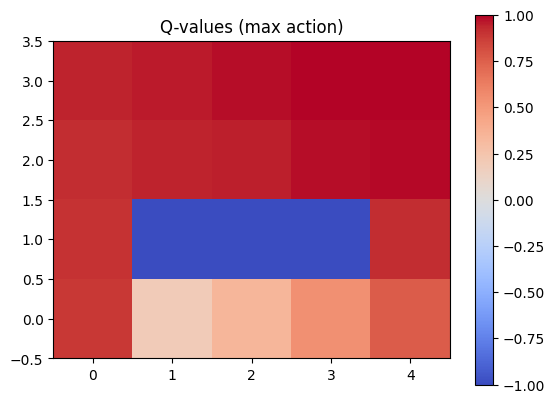

 →  →  →  →  G 
 →  →  →  ↑  ↑ 
 →  ■  ■  ■  ↑ 
 →  →  →  →  ↑ 


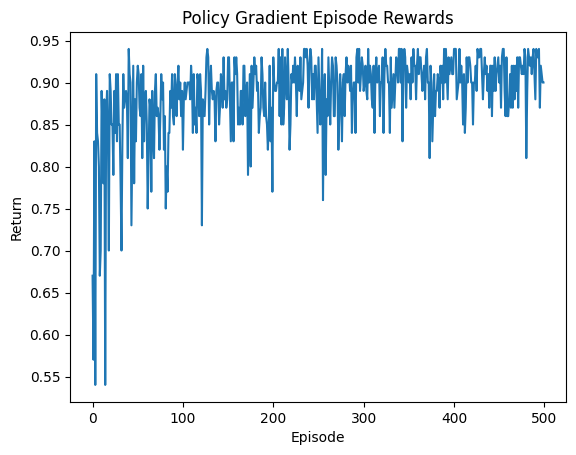

In [ ]:
# Maze: 5x4, Start=(0,0), Goal=(4,3), Walls={(1,1),(2,1),(3,1)}
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import random

# --- Environment ---
class MazeEnv:
    def __init__(self):
        self.width, self.height = 5, 4
        self.start = (0,0)
        self.goal = (4,3)
        self.walls = {(1,1),(2,1),(3,1)}
        self.reset()

    def reset(self):
        self.pos = self.start
        return self.state()

    def state(self):
        return np.array(self.pos)

    def step(self, action):
        x,y = self.pos
        moves = [(0,1),(0,-1),(1,0),(-1,0)]
        dx,dy = moves[action]
        nx,ny = x+dx,y+dy
        if (0<=nx<self.width and 0<=ny<self.height and (nx,ny) not in self.walls):
            self.pos = (nx,ny)
        reward = 1.0 if self.pos == self.goal else -0.01
        done = self.pos == self.goal
        return np.array(self.pos), reward, done

# --- Q-learning Table ---
def q_learning(env, episodes=500, alpha=0.1, gamma=0.99, eps=0.2):
    Q = np.zeros((env.width, env.height, 4))
    for _ in range(episodes):
        s = env.reset()
        done = False
        while not done:
            x,y = s
            if np.random.rand() < eps:
                a = np.random.randint(4)
            else:
                a = np.argmax(Q[x,y])
            ns,r,done = env.step(a)
            nx,ny = ns
            Q[x,y,a] += alpha * (r + gamma*np.max(Q[nx,ny]) - Q[x,y,a])
            s = ns
    return Q

# --- Policy Network (Neural Net) ---
class PolicyNet(nn.Module):
    def __init__(self, n_states=2, n_actions=4, hidden=32):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(n_states, hidden),
            nn.ReLU(),
            nn.Linear(hidden, n_actions)
        )
    def forward(self,x):
        return self.net(x)

def train_policy_gradient(env, episodes=500, gamma=0.99, lr=1e-2):
    policy = PolicyNet()
    optimizer = optim.Adam(policy.parameters(), lr=lr)
    rewards_history = []

    for ep in range(episodes):
        log_probs, rewards = [], []
        s = env.reset()
        done = False
        while not done:
            state_t = torch.FloatTensor(s/np.array([env.width, env.height]))
            logits = policy(state_t)
            probs = torch.softmax(logits, dim=0)
            dist = torch.distributions.Categorical(probs)
            a = dist.sample()
            log_probs.append(dist.log_prob(a))
            ns,r,done = env.step(a.item())
            rewards.append(r)
            s = ns

        # compute returns
        R, returns = 0, []
        for r in reversed(rewards):
            R = r + gamma*R
            returns.insert(0, R)
        returns = torch.FloatTensor(returns)
        returns = (returns - returns.mean()) / (returns.std() + 1e-8)

        loss = -torch.stack([lp*G for lp,G in zip(log_probs, returns)]).sum()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        rewards_history.append(sum(rewards))
    return policy, rewards_history

# --- Run Both ---
env = MazeEnv()

Q = q_learning(env, episodes=500)
policy, pg_rewards = train_policy_gradient(env, episodes=500)

# --- Visualization ---
def visualize_q(Q, env):
    grid = np.zeros((env.height, env.width))
    for x in range(env.width):
        for y in range(env.height):
            if (x,y) in env.walls:
                grid[y,x] = -1
            elif (x,y) == env.goal:
                grid[y,x] = 1
            else:
                grid[y,x] = np.max(Q[x,y])
    plt.imshow(grid, cmap="coolwarm", origin="lower")
    plt.title("Q-values (max action)")
    plt.colorbar()
    plt.show()

def visualize_policy(policy, env):
    arrows = ["↑","↓","→","←"]
    for y in reversed(range(env.height)):
        row = ""
        for x in range(env.width):
            if (x,y) in env.walls:
                row += " ■ "
            elif (x,y) == env.goal:
                row += " G "
            else:
                s = torch.FloatTensor(np.array([x,y])/np.array([env.width,env.height]))
                a = torch.argmax(policy(s)).item()
                row += f" {arrows[a]} "
        print(row)

visualize_q(Q, env)
visualize_policy(policy, env)

plt.plot(pg_rewards)
plt.title("Policy Gradient Episode Rewards")
plt.xlabel("Episode")
plt.ylabel("Return")
plt.show()


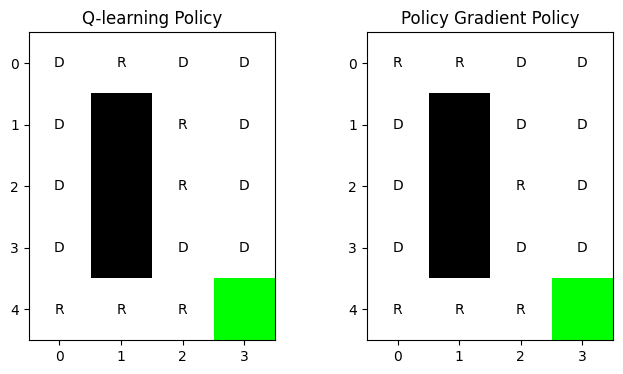

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import random
from IPython.display import clear_output
import time

# --- Maze Setup (5x4 grid) ---
rows, cols = 5, 4
start, goal = (0, 0), (4, 3)
obstacles = {(1,1), (2,1), (3,1)}  # walls in the middle column

actions = [(0,1), (0,-1), (1,0), (-1,0)]  # R, L, D, U
n_actions = len(actions)

def is_valid(state):
    (x, y) = state
    return (0 <= x < rows) and (0 <= y < cols) and (state not in obstacles)

def step(state, action):
    new_state = (state[0] + actions[action][0], state[1] + actions[action][1])
    if not is_valid(new_state):
        return state, -1, False
    if new_state == goal:
        return new_state, 10, True
    return new_state, -0.1, False

# --- Q-learning ---
Q = np.zeros((rows, cols, n_actions))
alpha, gamma, eps = 0.1, 0.9, 0.2

# --- Policy Network (PyTorch) ---
class PolicyNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(rows*cols, 64),
            nn.ReLU(),
            nn.Linear(64, n_actions),
            nn.Softmax(dim=-1)
        )
    def forward(self, x):
        return self.net(x)

policy_net = PolicyNet()
optimizer = optim.Adam(policy_net.parameters(), lr=0.01)

def one_hot_state(s):
    x = torch.zeros(rows*cols)
    x[s[0]*cols + s[1]] = 1.0
    return x

# --- Training Loop ---
episodes = 200
frames = []

for ep in range(episodes):
    # Q-learning episode
    state = start
    done = False
    while not done:
        if random.random() < eps:
            a = random.randint(0, n_actions-1)
        else:
            a = np.argmax(Q[state[0], state[1]])
        new_state, r, done = step(state, a)
        Q[state[0], state[1], a] += alpha * (r + gamma * np.max(Q[new_state[0], new_state[1]]) - Q[state[0], state[1], a])
        state = new_state

    # Policy Gradient episode
    state = start
    log_probs, rewards = [], []
    done = False
    while not done:
        s_vec = one_hot_state(state)
        probs = policy_net(s_vec)
        dist = torch.distributions.Categorical(probs)
        action = dist.sample()
        log_probs.append(dist.log_prob(action))
        new_state, r, done = step(state, action.item())
        rewards.append(r)
        state = new_state

    # Policy Gradient update
    R = 0
    returns = []
    for r in reversed(rewards):
        R = r + gamma * R
        returns.insert(0, R)
    returns = torch.tensor(returns)
    returns = (returns - returns.mean()) / (returns.std() + 1e-9)
    loss = -torch.stack([lp * G for lp, G in zip(log_probs, returns)]).sum()
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    # --- Collect frame (every 10 episodes) ---
    if ep % 10 == 0:
        frame = np.zeros((rows, cols, 3))
        for r in range(rows):
            for c in range(cols):
                if (r,c) in obstacles:
                    frame[r,c] = [0,0,0]
                elif (r,c) == goal:
                    frame[r,c] = [0,1,0]
                else:
                    frame[r,c] = [1,1,1]
        frames.append((frame, Q.copy(), policy_net.state_dict()))

# --- Animate ---
for i, (frame, Qsnap, polsnap) in enumerate(frames):
    clear_output(wait=True)
    fig, axes = plt.subplots(1,2, figsize=(8,4))

    # Q-learning greedy policy
    q_policy = np.full((rows, cols), ' ')
    for r in range(rows):
        for c in range(cols):
            if (r,c) in obstacles: continue
            if (r,c) == goal: continue
            best = np.argmax(Qsnap[r,c])
            q_policy[r,c] = ['R','L','D','U'][best]
    axes[0].imshow(frame)
    for r in range(rows):
        for c in range(cols):
            axes[0].text(c,r,q_policy[r,c],ha='center',va='center')
    axes[0].set_title("Q-learning Policy")

    # PolicyNet greedy policy
    policy_net.load_state_dict(polsnap)
    nn_policy = np.full((rows, cols), ' ')
    for r in range(rows):
        for c in range(cols):
            if (r,c) in obstacles: continue
            if (r,c) == goal: continue
            s_vec = one_hot_state((r,c))
            probs = policy_net(s_vec)
            a = torch.argmax(probs).item()
            nn_policy[r,c] = ['R','L','D','U'][a]
    axes[1].imshow(frame)
    for r in range(rows):
        for c in range(cols):
            axes[1].text(c,r,nn_policy[r,c],ha='center',va='center')
    axes[1].set_title("Policy Gradient Policy")

    plt.show()
    time.sleep(0.3)


In [ ]:
# === Install dependency ===
!pip -q install python-chess

# === Imports ===
import chess
import chess.pgn
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from math import inf

# -----------------------------
# Utility: Encode board state
# -----------------------------
# 12 piece planes: [wP,wN,wB,wR,wQ,wK, bP,bN,bB,bR,bQ,bK] + 1 plane for side-to-move
PIECE_ORDER = [
    (chess.PAWN,   True),
    (chess.KNIGHT, True),
    (chess.BISHOP, True),
    (chess.ROOK,   True),
    (chess.QUEEN,  True),
    (chess.KING,   True),
    (chess.PAWN,   False),
    (chess.KNIGHT, False),
    (chess.BISHOP, False),
    (chess.ROOK,   False),
    (chess.QUEEN,  False),
    (chess.KING,   False),
]

def board_to_tensor(board: chess.Board):
    planes = []
    for piece_type, is_white in PIECE_ORDER:
        bb = board.pieces(piece_type, chess.WHITE if is_white else chess.BLACK)
        plane = np.zeros(64, dtype=np.float32)
        for sq in bb:
            plane[sq] = 1.0
        planes.append(plane)
    # side-to-move plane (all 1s if white to move, else 0s)
    stm = np.ones(64, dtype=np.float32) if board.turn == chess.WHITE else np.zeros(64, dtype=np.float32)
    planes.append(stm)
    x = np.concatenate(planes)  # shape (13*64,)
    return torch.tensor(x, dtype=torch.float32)

# -----------------------------
# Move indexing (4672 action space)
# -----------------------------
# We index ALL possible from->to moves plus promotions. Illegal moves get masked.
# Index = from_sq*73 + move_offset  (73 max moves per from_sq incl promos is a safe upper bound)
# To keep it simple and robust, we’ll just build mapping from all UCI strings we might need.
ALL_ACTIONS = []

def generate_all_actions():
    # Generate all non-promotion moves
    for from_sq in range(64):
        for to_sq in range(64):
            if from_sq == to_sq:
                continue
            uci = chess.SQUARE_NAMES[from_sq] + chess.SQUARE_NAMES[to_sq]
            ALL_ACTIONS.append(uci)
    # Add promotions (to q,r,b,n) for pawn pushes from rank 7 (white) and rank 2 (black)
    promos = ['q','r','b','n']
    for file in 'abcdefgh':
        # white promotions (to rank 8)
        for to_rank in ['8']:
            for promo in promos:
                for from_rank in ['7']:  # push, captures handled by to files left/right
                    # Forward push
                    ALL_ACTIONS.append(f"{file}{from_rank}{file}{to_rank}{promo}")
                # Captures to left/right (files adjacent if exist)
                left_file = chr(ord(file)-1) if file > 'a' else None
                right_file = chr(ord(file)+1) if file < 'h' else None
                if left_file:
                    ALL_ACTIONS.append(f"{file}7{left_file}8{promo}")
                if right_file:
                    ALL_ACTIONS.append(f"{file}7{right_file}8{promo}")
        # black promotions (to rank 1)
        for to_rank in ['1']:
            for promo in promos:
                for from_rank in ['2']:
                    ALL_ACTIONS.append(f"{file}{from_rank}{file}{to_rank}{promo}")
                left_file = chr(ord(file)-1) if file > 'a' else None
                right_file = chr(ord(file)+1) if file < 'h' else None
                if left_file:
                    ALL_ACTIONS.append(f"{file}2{left_file}1{promo}")
                if right_file:
                    ALL_ACTIONS.append(f"{file}2{right_file}1{promo}")

generate_all_actions()
ACTION_TO_IDX = {uci:i for i, uci in enumerate(ALL_ACTIONS)}
IDX_TO_ACTION = {i:uci for uci,i in ACTION_TO_IDX.items()}
ACTION_SIZE = len(ALL_ACTIONS)

# -----------------------------
# Policy Network
# -----------------------------
class PolicyNet(nn.Module):
    def __init__(self, input_dim=13*64, hidden=512, action_dim=ACTION_SIZE):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, hidden),
            nn.ReLU(),
            nn.Linear(hidden, hidden//2),
            nn.ReLU(),
            nn.Linear(hidden//2, action_dim)
        )
    def forward(self, x):
        return self.net(x)  # logits over all actions

# -----------------------------
# Mask illegal moves
# -----------------------------
def legal_mask(board: chess.Board):
    mask = torch.full((ACTION_SIZE,), fill_value=False, dtype=torch.bool)
    for mv in board.legal_moves:
        uci = mv.uci()
        if uci in ACTION_TO_IDX:
            mask[ACTION_TO_IDX[uci]] = True
    return mask

def sample_legal_action(policy: PolicyNet, board: chess.Board, temperature=1.0):
    x = board_to_tensor(board)
    logits = policy(x)
    # Mask illegal moves
    mask = legal_mask(board)
    if not mask.any():
        return None, None, None  # stalemate or no legal moves
    masked_logits = logits.clone()
    masked_logits[~mask] = -1e9  # effectively -inf
    if temperature != 1.0:
        masked_logits = masked_logits / max(temperature, 1e-6)
    probs = torch.softmax(masked_logits, dim=0)
    dist = torch.distributions.Categorical(probs)
    idx = dist.sample()
    uci = IDX_TO_ACTION[idx.item()]
    return uci, dist.log_prob(idx), probs[idx]

# -----------------------------
# Reward Shaping
# -----------------------------
def reward_for_agent_move(board_before, board_after, agent_move: chess.Move, game_over_result=None):
    """
    Rewards applied immediately after the agent's own move:
      +0.2 for any legal move
      +0.4 extra if that move captured a piece
      +5.0 if that move checkmates opponent
      -0.01 step penalty
    """
    r = 0.2 - 0.01
    if board_before.is_capture(agent_move):
        r += 0.4
    if game_over_result is not None:
        # game_over_result in {'1-0','0-1','1/2-1/2'}
        # If it's agent's move (agent assumed plays White by default here; we’ll let you choose), we’ll resolve below.
        pass
    # Checkmate detection after applying the move:
    if board_after.is_game_over():
        res = board_after.result()
        # If agent just delivered mate, it must be opponent to move and game over; give +5 if agent won
        # We'll resolve win/loss based on side-to-move we assign to agent.
        # Here we'll not assign yet; outer loop will add +/- 5 appropriately.
    return r

def reward_for_opponent_move(board_before, opponent_move: chess.Move):
    """
    Penalty if opponent captures our piece:
      -1.0 if opponent captured
    No extra for regular non-capturing opponent moves.
    """
    return -1.0 if board_before.is_capture(opponent_move) else 0.0

# -----------------------------
# Pretty print
# -----------------------------
def print_board(board):
    print(board.unicode(borders=True, invert_color=False))
    print(f"FEN: {board.fen()}")
    print()

# -----------------------------
# Interactive Game Loop (learns during play)
# -----------------------------
def play_human_vs_rl(agent_color='white', lr=1e-3, temperature=1.0):
    """
    agent_color: 'white' or 'black'
    You play the other color.
    """
    device = 'cpu'
    policy = PolicyNet().to(device)
    optimizer = optim.Adam(policy.parameters(), lr=lr)

    board = chess.Board()
    agent_is_white = (agent_color.lower() == 'white')
    print("Type moves in UCI (e.g., e2e4). Type 'resign' or 'quit' to stop.\n")
    print_board(board)

    # For REINFORCE: collect (log_prob, total_reward) per agent action
    last_agent_logprob = None
    cumulative_loss = torch.tensor(0.0)

    move_number = 1
    while not board.is_game_over():
        if board.turn == chess.WHITE and agent_is_white or board.turn == chess.BLACK and not agent_is_white:
            # Agent's turn
            uci, logprob, _ = sample_legal_action(policy, board, temperature=temperature)
            if uci is None:
                print("No legal moves for agent (stalemate?).")
                break
            mv = chess.Move.from_uci(uci)
            before = board.copy()
            board.push(mv)
            after = board

            # Base reward from agent's move
            r_agent = reward_for_agent_move(before, after, mv)

            # If the move immediately ends the game, add terminal reward:
            if after.is_game_over():
                res = after.result()
                if (res == '1-0' and agent_is_white) or (res == '0-1' and not agent_is_white):
                    r_agent += 5.0
                elif (res == '1-0' and not agent_is_white) or (res == '0-1' and agent_is_white):
                    r_agent -= 5.0

            print(f"Agent plays: {uci}  (reward so far: {r_agent:+.2f})")
            print_board(board)

            # Store for update after we also see your reply (so we can include your capture penalty)
            last_agent_logprob = logprob
            last_agent_reward = r_agent

            if after.is_game_over():
                # Final update and break
                loss = -(last_agent_logprob * torch.tensor(last_agent_reward, dtype=torch.float32))
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                print(f"Game over. Result: {after.result()} (updated policy)")
                break

        else:
            # Human turn
            while True:
                user = input("Your move (UCI, e.g., e2e4; 'resign' to quit): ").strip().lower()
                if user in ('quit','resign','exit'):
                    print("You resigned / ended the session.")
                    return
                try:
                    mv = chess.Move.from_uci(user)
                except Exception:
                    print("Invalid UCI format. Try again.")
                    continue
                if mv in board.legal_moves:
                    before = board.copy()
                    board.push(mv)
                    after = board
                    # Opponent (you) capture penalty to agent:
                    r_opp = reward_for_opponent_move(before, mv)

                    # If your move ends the game, add terminal reward (from agent's perspective)
                    if after.is_game_over():
                        res = after.result()
                        if (res == '1-0' and agent_is_white) or (res == '0-1' and not agent_is_white):
                            # Agent won
                            terminal = +5.0
                        elif (res == '1-0' and not agent_is_white) or (res == '0-1' and agent_is_white):
                            # Agent lost
                            terminal = -5.0
                        else:
                            terminal = 0.0
                        r_opp += terminal

                    print(f"You played: {user}  (agent receives additional reward {r_opp:+.2f})")
                    print_board(board)

                    # ---- REINFORCE update for the agent's last action ----
                    if last_agent_logprob is not None:
                        total_reward = last_agent_reward + r_opp
                        loss = -(last_agent_logprob * torch.tensor(total_reward, dtype=torch.float32))
                        optimizer.zero_grad()
                        loss.backward()
                        optimizer.step()
                        last_agent_logprob = None  # consumed
                    break
                else:
                    print("Illegal move in this position. Try again.")

        move_number += 1

    if board.is_game_over():
        print(f"Game over. Result: {board.result()}")

# -----------------------------
# Run it!
# -----------------------------
# Choose which color the agent plays: 'white' (agent moves first) or 'black'
play_human_vs_rl(agent_color='white', lr=1e-3, temperature=1.0)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 85.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
Type moves in UCI (e.g., e2e4). Type 'resign' or 'quit' to stop.

  -----------------
8 |♜|♞|♝|♛|♚|♝|♞|♜|
  -----------------
7 |♟|♟|♟|♟|♟|♟|♟|♟|
  -----------------
6 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
5 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
4 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
3 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
2 |♙|♙|♙|♙|♙|♙|♙|♙|
  -----------------
1 |♖|♘|♗|♕|♔|♗|♘|♖|
  -----------------
   a b c d e f g h
FEN: rnbqkbnr/pppppppp/8/8/8/8/PPPPPPPP/RNBQKBNR w KQkq - 0 1

Agent plays: a2a4  (reward so far: +0.19)
  -----------------
8 |♜|♞|♝|♛|♚|♝|♞|♜|
  -----------------
7 |♟|♟|♟|♟|♟|♟|♟|♟|
  -----------------
6 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
5 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
4 |♙|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
3 |⭘|⭘|⭘|⭘|⭘|⭘|⭘|⭘|
  -----------------
2 |⭘|♙|♙|♙|♙|♙|♙|♙|
  -----------------
1 |♖|♘|♗|♕|♔|♗|♘|♖|
  -----------------
   a b c d